<a href="https://colab.research.google.com/github/Arturro-98/Object_detection_and_tracking/blob/main/Project_V5_0.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# If want to check what graphic card is available to utilize the code
!nvidia-smi

Sun Sep 11 19:05:27 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   33C    P0    28W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('Not using a high-RAM runtime')
else:
  print('You are using a high-RAM runtime!')

Your runtime has 27.3 gigabytes of available RAM

You are using a high-RAM runtime!


In [ ]:
# Mounting colab with Google Drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Going/changing directory into project location on drive
%cd 'drive/MyDrive/Colab_Notebooks/MSc_Project/Project_V5'

/content/drive/MyDrive/Colab_Notebooks/MSc_Project/Project_V5


In [ ]:
# Giving all the data for training in colab makes in quicker (access)
!unzip '/content/drive/MyDrive/Colab_Notebooks/MSc_Project/DataSets/Tennis_V4.zip' -d '/content/'

Archive:  /content/drive/MyDrive/Colab_Notebooks/MSc_Project/DataSets/Tennis_V4.zip
   creating: /content/Tennis_V4/
   creating: /content/Tennis_V4/images/
   creating: /content/Tennis_V4/images/train/
  inflating: /content/Tennis_V4/images/train/1.jpg  
  inflating: /content/Tennis_V4/images/train/10.jpg  
  inflating: /content/Tennis_V4/images/train/100.jpg  
  inflating: /content/Tennis_V4/images/train/101.jpg  
  inflating: /content/Tennis_V4/images/train/103.jpg  
  inflating: /content/Tennis_V4/images/train/104.jpg  
  inflating: /content/Tennis_V4/images/train/105.jpg  
  inflating: /content/Tennis_V4/images/train/106.jpg  
  inflating: /content/Tennis_V4/images/train/107.jpg  
  inflating: /content/Tennis_V4/images/train/108.jpg  
  inflating: /content/Tennis_V4/images/train/11.jpg  
  inflating: /content/Tennis_V4/images/train/111.jpg  
  inflating: /content/Tennis_V4/images/train/116.jpg  
  inflating: /content/Tennis_V4/images/train/119.jpg  
  inflating: /content/Tennis_V4

In [ ]:
# Cloning Github repository from official Yolov5 ultralytics. Since stored on drive, need to do only once
# More about YOLOv5 from ultralytics: https://github.com/ultralytics/yolov5   &    https://docs.ultralytics.com/

# !git clone https://github.com/ultralytics/yolov5  # clone
# %cd yolov5
# %pip install -qr requirements.txt  # install

# import torch
# import utils
# display = utils.notebook_init()  # checks

YOLOv5 🚀 v6.1-316-g916bdb1 Python-3.7.13 torch-1.12.0+cu113 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)


Setup complete ✅ (4 CPUs, 25.5 GB RAM, 39.3/166.8 GB disk)


# **YOLOv5**

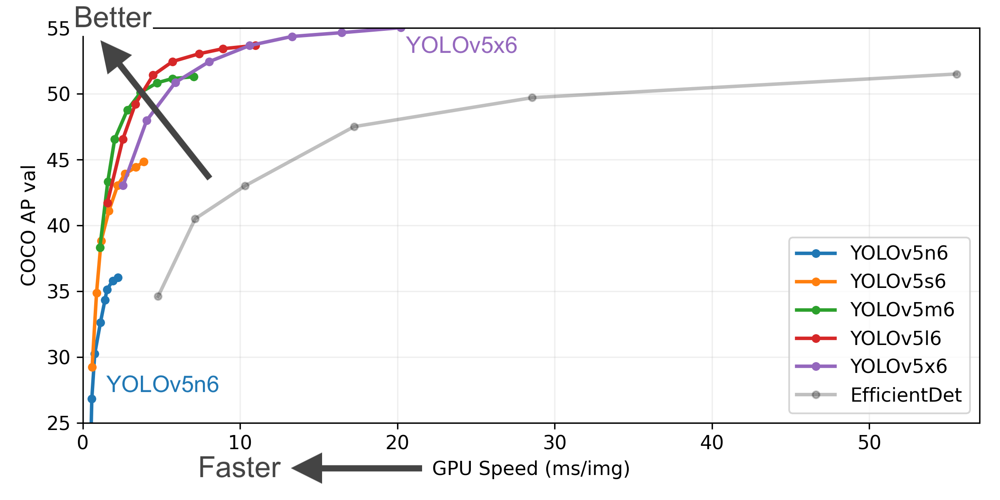

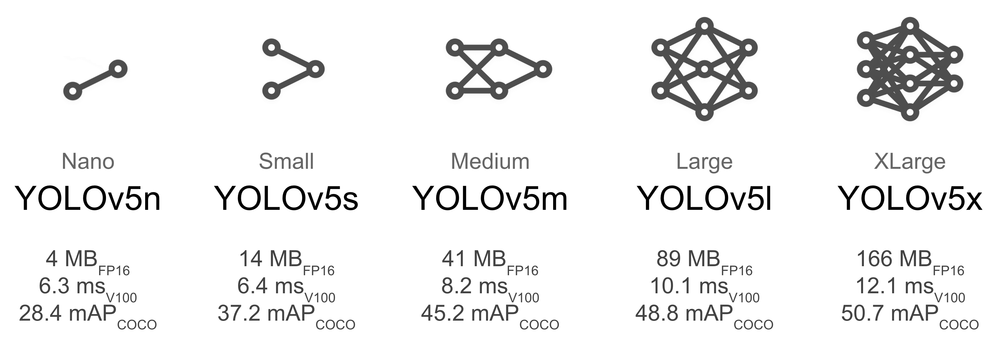

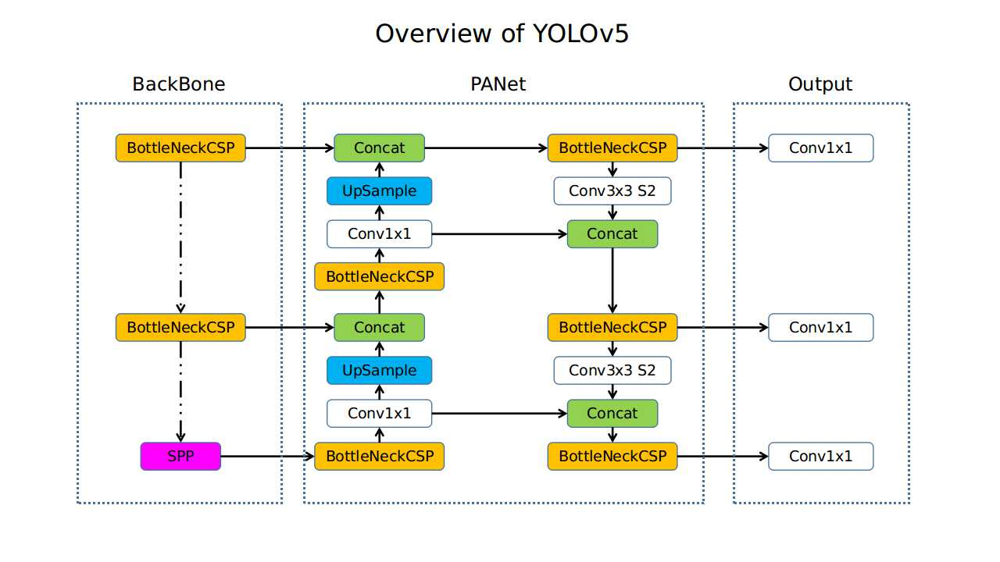

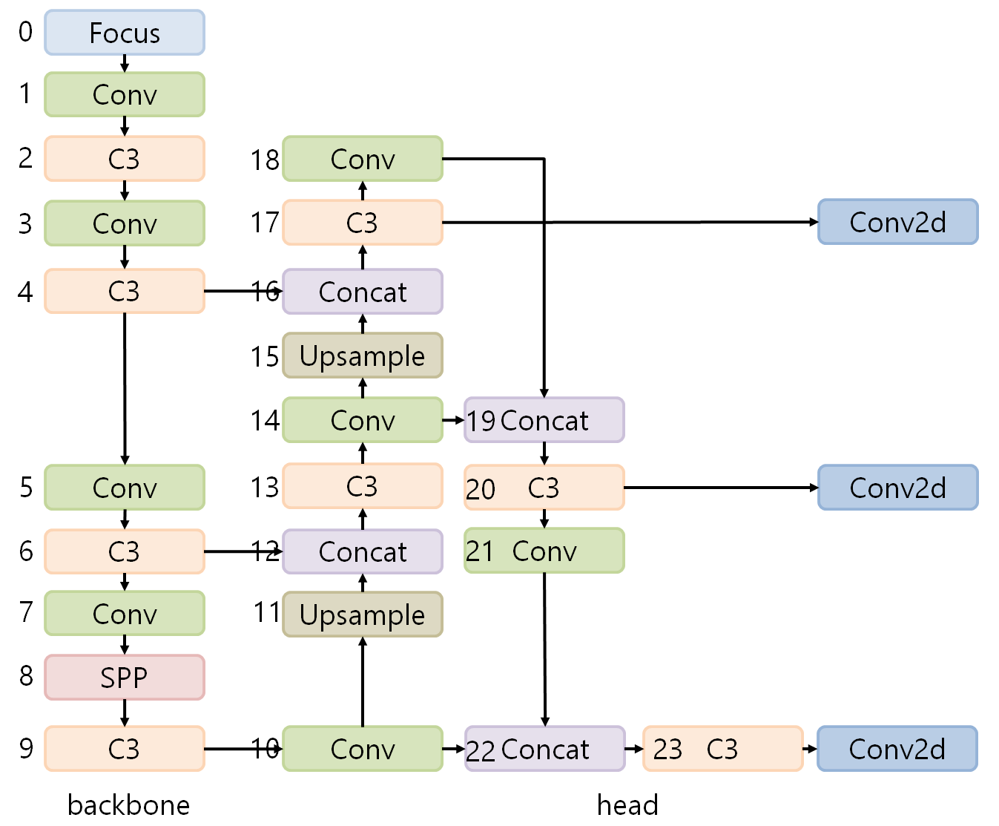

# Train the model

If want to train the model on custom data:
1. Need to modify and upload .yaml file from:
"/content/drive/MyDrive/Colab_Notebooks/MSc_Project/Project_V5/yolov5/data/coco128.yaml"
It will show a model the path to the data together with the classes that want to train the model for
2. Upload modified file to above directory

Useful files:
hyperparameters-configurations in ‘data/hyp/hyp.scratch.yaml’

In [ ]:
#make sure that in '/content/drive/MyDrive/Colab_Notebooks/MSc_Project/Project_V5/yolov5' directory
%cd 'yolov5'

/content/drive/MyDrive/Colab_Notebooks/MSc_Project/Project_V5/yolov5


In [ ]:
# Installing the required packages specified in the requirements.txt
%pip install -qr requirements.txt  # install

import torch
import utils
display = utils.notebook_init()  # checks

INFO:yolov5:YOLOv5 🚀 v6.1-316-g916bdb1 Python-3.7.13 torch-1.12.1+cu113 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)
YOLOv5 🚀 v6.1-316-g916bdb1 Python-3.7.13 torch-1.12.1+cu113 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)


Setup complete ✅ (4 CPUs, 25.5 GB RAM, 37.7/166.8 GB disk)


In [ ]:
!pip install -U albumentations
!echo "$(pip freeze | grep albumentations) " # To check the version of albumentations library necessary for data augmentation

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
albumentations==1.2.1 


In [ ]:
# For 'Medium' model
!python train.py --img 640 --batch 4 --epochs 750 --data custom_data.yaml --weights yolov5m.pt --cache

train: weights=yolov5m.pt, cfg=, data=custom_data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=750, batch_size=4, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-316-g916bdb1 Python-3.7.13 torch-1.12.0+cu113 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=

In [ ]:
# For 'Extra Large' model. SGD and image size 800
import time
start_time = time.time()

!python train.py --patience 0 --img 800 --batch 8 --epochs 650 --data custom_data.yaml --weights yolov5x.pt --cache

print("The code was executed in %s seconds " % (time.time() - start_time))

train: weights=yolov5x.pt, cfg=, data=custom_data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=650, batch_size=8, imgsz=800, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=0, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: ⚠️ YOLOv5 is out of date by 14 commits. Use `git pull` or `git clone https://github.com/ultralytics/yolov5` to update.
YOLOv5 🚀 v6.1-316-g916bdb1 Python-3.7.13 torch-1.12.0+cu113 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.

In [ ]:
# For 'Extra Large' model with data augmentation and Adam optimizer instead of SGD
import time
start_time = time.time()

# batch '-1' for auto batch size/maximum that hardware allows
!python train.py --patience 0 --img 800 --batch -1 --optimizer Adam --epochs 500 --data custom_data.yaml --weights yolov5x.pt --cache --name Xtra_Large_Adam_img_800

print("The code was executed in %s seconds " % (time.time() - start_time))

train: weights=yolov5x.pt, cfg=, data=custom_data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=500, batch_size=-1, imgsz=800, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=Adam, sync_bn=False, workers=8, project=runs/train, name=Xtra_Large_Adam_img_800, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=0, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
Command 'git fetch && git config --get remote.origin.url' timed out after 5 seconds
YOLOv5 🚀 v6.1-316-g916bdb1 Python-3.7.13 torch-1.12.1+cu113 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_

In [ ]:
# For 'Extra Large' model with data augmentation and Adam optimizer instead of SGD + image size 1280
import time
start_time = time.time()

# batch '-1' for auto batch size/maximum that hardware allows
!python train.py --patience 0 --img 1280 --batch -1 --optimizer Adam --epochs 200 --data custom_data.yaml --weights yolov5x.pt --cache --name Xtra_Large_Adam_img_1280

print("The code was executed in %s seconds " % (time.time() - start_time))

train: weights=yolov5x.pt, cfg=, data=custom_data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=200, batch_size=-1, imgsz=1280, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=Adam, sync_bn=False, workers=8, project=runs/train, name=Xtra_Large_Adam_img_1280, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=0, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
Command 'git fetch && git config --get remote.origin.url' timed out after 5 seconds
YOLOv5 🚀 v6.1-316-g916bdb1 Python-3.7.13 torch-1.12.1+cu113 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, ancho

In [ ]:
# For 'yolov5x6' (the largest) model with data augmentation and SGD optimizer + image resolution 1280
import time
start_time = time.time()

# batch '-1' for auto batch size/maximum that hardware allows
!python train.py --patience 0 --img 1280 --batch -1  --epochs 400 --data custom_data.yaml --weights yolov5x6.pt --cache --name Largest_model_SGD_img_1280

print("The code was executed in %s seconds " % (time.time() - start_time))

train: weights=yolov5x6.pt, cfg=, data=custom_data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=400, batch_size=-1, imgsz=1280, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=Largest_model_SGD_img_1280, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=0, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
Command 'git fetch && git config --get remote.origin.url' timed out after 5 seconds
YOLOv5 🚀 v6.1-316-g916bdb1 Python-3.7.13 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, f

**Training from scratch**
When having a large enough dataset, the model will benefit most by training from scratch. The weights are randomly initialized by passing an empty string (‘ ‘) to the weights argument.
https://towardsdatascience.com/the-practical-guide-for-object-detection-with-yolov5-algorithm-74c04aac4843


In [ ]:
import time
start_time = time.time()

# batch '-1' for auto batch size/maximum that hardware allows
!python train.py --img 1280 --batch -1 --epochs 500 --data custom_data.yaml --weights '' --cfg 'models/yolov5x.yaml' --cache --hyp hyp.scratch-low.yaml --name From_scratch_Xtra_Large_img_1280

#python train.py --hyp hyp.scratch-low.yaml

print("The code was executed in %s seconds " % (time.time() - start_time))

train: weights=, cfg=models/yolov5x.yaml, data=custom_data.yaml, hyp=hyp.scratch-low.yaml, epochs=500, batch_size=-1, imgsz=1280, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=From_scratch_Xtra_Large_img_1280, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: ⚠️ YOLOv5 is out of date by 137 commits. Use `git pull` or `git clone https://github.com/ultralytics/yolov5` to update.
YOLOv5 🚀 v6.1-316-g916bdb1 Python-3.7.13 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.

In [ ]:
import time
start_time = time.time()

# batch '-1' for auto batch size/maximum that hardware allows
!python train.py --img 1280 --patience 0 --batch -1 --optimizer Adam --epochs 500 --data custom_data.yaml --weights '' --cfg 'models/yolov5x.yaml' --cache --hyp hyp.scratch-low.yaml --name From_scratch_Adam_Xtra_Large_img_1280

#python train.py --hyp hyp.scratch-low.yaml

print("The code was executed in %s seconds " % (time.time() - start_time))

python3: can't open file 'train.py': [Errno 2] No such file or directory
The code was executed in 0.12215399742126465 seconds 





**Retrain the model if needed, starting from the last point**

In [ ]:
# /content/drive/MyDrive/Colab_Notebooks/MSc_Project/Project_V5/yolov5/runs/train/exp6/weights/last.pt
!python train.py --img 1280 --batch -1 --optimizer Adam --epochs 200 --data custom_data.yaml --weights runs/train/Xtra_Large_Adam_img_1280/weights/last.pt --name Xtra_Large_Adam_img_1280_R1
#CHECK THIS:
#!python train.py --weights runs/train/exp6/weights/last.pt --epochs 60 --img 640

train: weights=runs/train/Xtra_Large_Adam_img_1280/weights/last.pt, cfg=, data=custom_data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=200, batch_size=-1, imgsz=1280, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=Adam, sync_bn=False, workers=8, project=runs/train, name=Xtra_Large_Adam_img_1280_R1, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: ⚠️ YOLOv5 is out of date by 137 commits. Use `git pull` or `git clone https://github.com/ultralytics/yolov5` to update.
YOLOv5 🚀 v6.1-316-g916bdb1 Python-3.7.13 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bi

In [ ]:
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

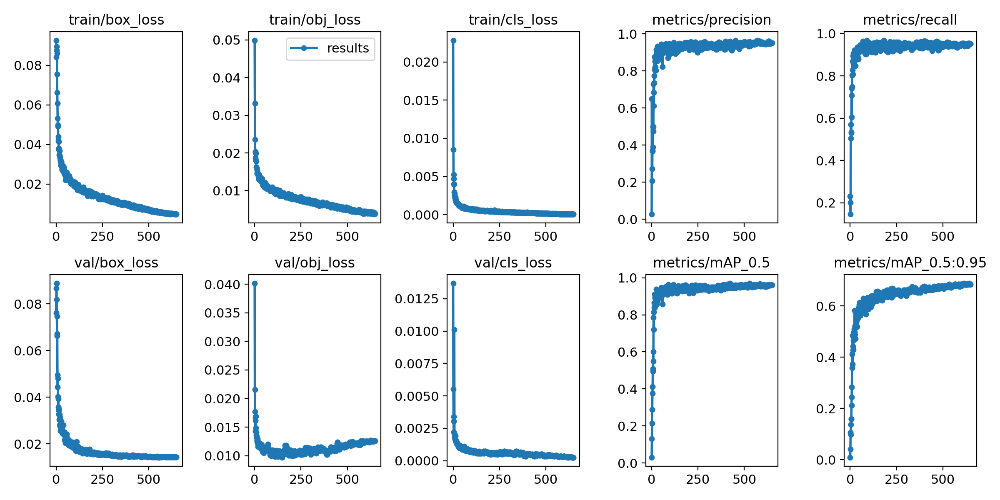

In [ ]:
from utils.plots import plot_results
plot_results('runs/train/exp4/weights')
display.Image(filename = '/content/drive/MyDrive/Colab_Notebooks/MSc_Project/Project_V5/yolov5/runs/train/exp4/results.png' , width=800)


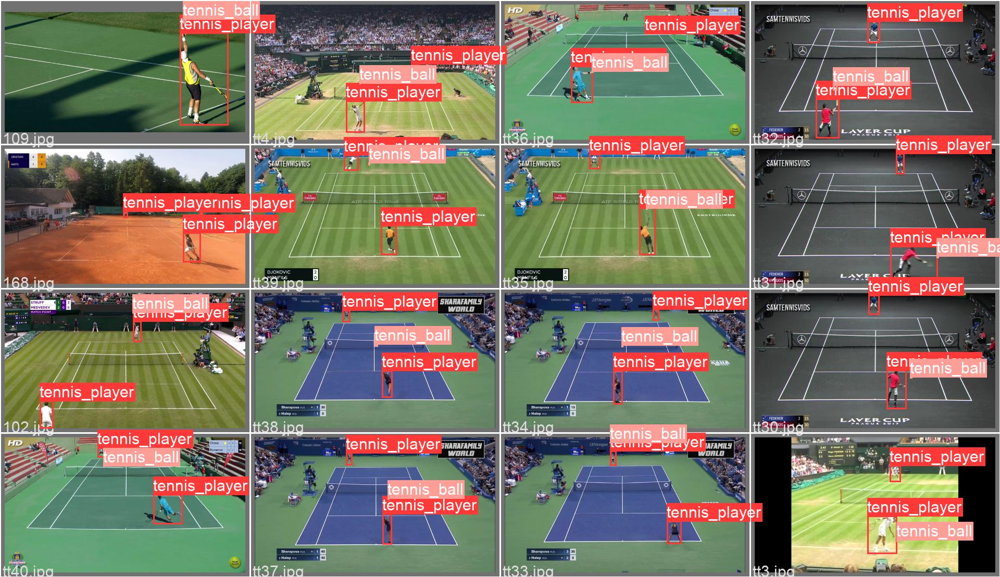

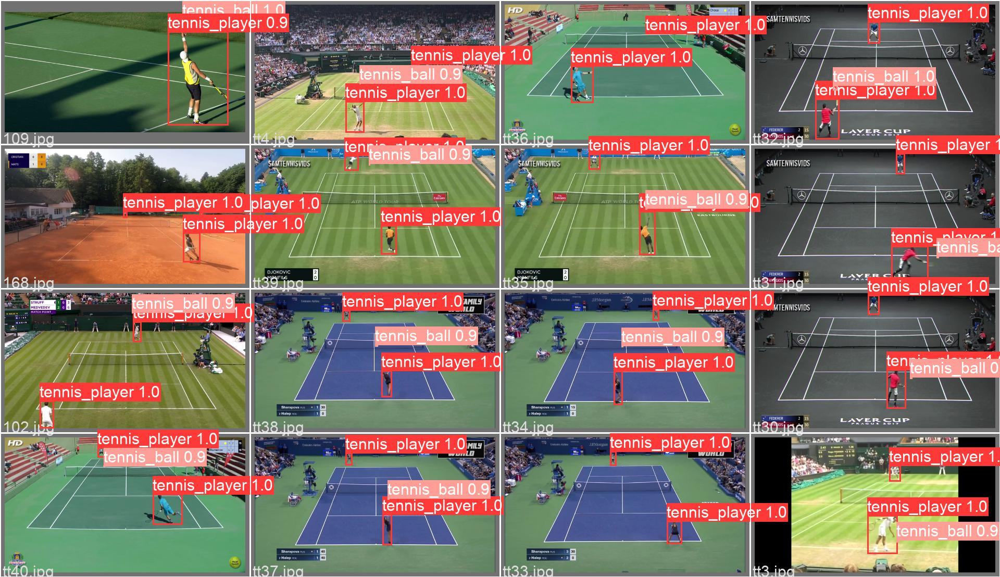

In [ ]:
# To show predicted results from training batch images
import cv2
from google.colab.patches import cv2_imshow
labelled_img = cv2.imread('/content/drive/MyDrive/Colab_Notebooks/MSc_Project/Project_V5/yolov5/runs/train/exp4/val_batch0_labels.jpg', cv2.IMREAD_ANYCOLOR)
cv2_imshow(labelled_img)
pred_img = cv2.imread('/content/drive/MyDrive/Colab_Notebooks/MSc_Project/Project_V5/yolov5/runs/train/exp4/val_batch0_pred.jpg', cv2.IMREAD_ANYCOLOR)
cv2_imshow(pred_img)

Test on unseen data using weight from previously trained model

In [ ]:
# make sure to pick weights from 'the best' experiment
model_path = '/content/drive/MyDrive/Colab_Notebooks/MSc_Project/Project_V5/yolov5/runs/train/exp/weights/best.pt'
file_path =  '/content/test_video.mp4'
!python detect.py --weights {model_path} --img 640 --conf 0.25 --source {file_path}
#Check this to save bounding boxes
# https://www.youtube.com/watch?v=2nR2e4J4ZaI (25:45)
#!python detect.py --weights {model_path} --img 640 --conf 0.25 --source {file_path} --save-txt --save-conf

detect: weights=['/content/drive/MyDrive/Colab_Notebooks/MSc_Project/Project_V4/yolov5/runs/train/exp/weights/best.pt'], source=/content/test_video.mp4, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-316-g916bdb1 Python-3.7.13 torch-1.12.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 290 layers, 20856975 parameters, 0 gradients, 47.9 GFLOPs
video 1/1 (1/161) /content/test_video.mp4: 384x640 2 tennis_players, 1 tennis_ball, Done. (0.022s)
video 1/1 (2/161) /content/test_video.mp4: 384x640 2 tennis_players, 1 tennis_ball, Done. (0.022s)
video 1/1 (3/161) /content/test_video.mp4: 384x640 2 tennis_players, 1 tennis_ball, Done

In [ ]:
!pwd

/content/drive/MyDrive/Colab_Notebooks/MSc_Project/Project_V4


# **Additionaly**

**Training from scratch**
When having a large enough dataset, the model will benefit most by training from scratch. The weights are randomly initialized by passing an empty string (‘ ‘) to the weights argument.
https://towardsdatascience.com/the-practical-guide-for-object-detection-with-yolov5-algorithm-74c04aac4843

batch — batch size (-1 for auto batch size). Use the largest batch size that your hardware allows for

In [ ]:
import time
start_time = time.time()

# Try batch '-1' for auto batch size/maximum that hardware allows
!python train.py --img 800 --batch 8 --epochs 300 --data custom_data.yaml --weights '' --cfg 'models/yolov5x.yaml' --cache

#python train.py --hyp hyp.scratch-low.yaml

print("The code was executed in %s seconds " % (time.time() - start_time))

train: weights=, cfg=models/yolov5x.yaml, data=custom_data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=300, batch_size=8, imgsz=800, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
Command 'git fetch && git config --get remote.origin.url' timed out after 5 seconds
YOLOv5 🚀 v6.1-316-g916bdb1 Python-3.7.13 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hs

Fine Tuning
Can adopt the hyperparameters

In [ ]:
!python train.py --hyp 'hyp.XXX.yaml' --batch 2 --epochs 120 --data 'data/XXX.yaml' --weights 'XXX/feature_extraction/weights/best.pt' --project 'XXX' --name 'fine-tuning' --cache

# **YOLOv6**

In [ ]:
# in: /content/drive/MyDrive/Colab_Notebooks/MSc_Project/Project_V5
!git clone https://github.com/meituan/YOLOv6

Cloning into 'YOLOv6'...
remote: Enumerating objects: 1381, done.
remote: Counting objects: 100% (301/301), done.
remote: Compressing objects: 100% (105/105), done.
remote: Total 1381 (delta 231), reused 218 (delta 196), pack-reused 1080
Receiving objects: 100% (1381/1381), 13.60 MiB | 10.27 MiB/s, done.
Resolving deltas: 100% (744/744), done.


In [ ]:
% cd 'YOLOv6'

/content/drive/MyDrive/Colab_Notebooks/MSc_Project/Project_V4/YOLOv6


In [ ]:
# Installing the required packages specified in the requirements.txt
%pip install -qr requirements.txt  # install

import torch
import utils
display = utils.notebook_init()  # checks

YOLOv5 🚀 v6.1-316-g916bdb1 Python-3.7.13 torch-1.12.0+cu113 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)


Setup complete ✅ (2 CPUs, 12.7 GB RAM, 40.1/166.8 GB disk)


1. Need to create '.yaml' file to show the data for the model (data/data_YOLOv6.yaml)
2. Download manually model weights from repository and place it into weights folder

In [ ]:
!python tools/train.py --batch 16 --conf configs/yolov6s_finetune.py --data-path data/data_YOLOv6.yaml --device 0 --epochs 150 --eval-interval 2

#!python tools/train.py --img 800 --batch 4 --epochs 150 --data data/data_YOLOv6.yaml --weights yolov6s.pt --cache

Using 1 GPU for training... 
training args are: Namespace(batch_size=16, check_images=False, check_labels=False, conf_file='configs/yolov6s_finetune.py', data_path='data/data_YOLOv6.yaml', device='0', dist_url='env://', epochs=150, eval_final_only=False, eval_interval=2, gpu_count=0, heavy_eval_range=50, img_size=640, local_rank=-1, name='exp', output_dir='./runs/train', rank=-1, resume=False, save_dir='runs/train/exp5', workers=8, world_size=1)

Train: Final numbers of valid images: 384/ labels: 384. 
0.0s for dataset initialization.
Convert to COCO format
100% 123/123 [00:00<00:00, 64094.84it/s]
Convert to COCO format finished. Resutls saved in /content/Tennis_V4/annotations/instances_val.json
Val: Final numbers of valid images: 123/ labels: 123. 
0.0s for dataset initialization.
Loading state_dict from ./weights/yolov6s.pt for fine-tuning...
Model: Model(
  (backbone): EfficientRep(
    (stem): RepVGGBlock(
      (nonlinearity): ReLU(inplace=True)
      (se): Identity()
      (rbr_d

###########################################

# **TRACKING**

https://www.researchgate.net/publication/352498971_Estimation_of_Lane-Level_Traffic_Flow_Using_a_Deep_Learning_Technique


Object tracking procedure of SORT

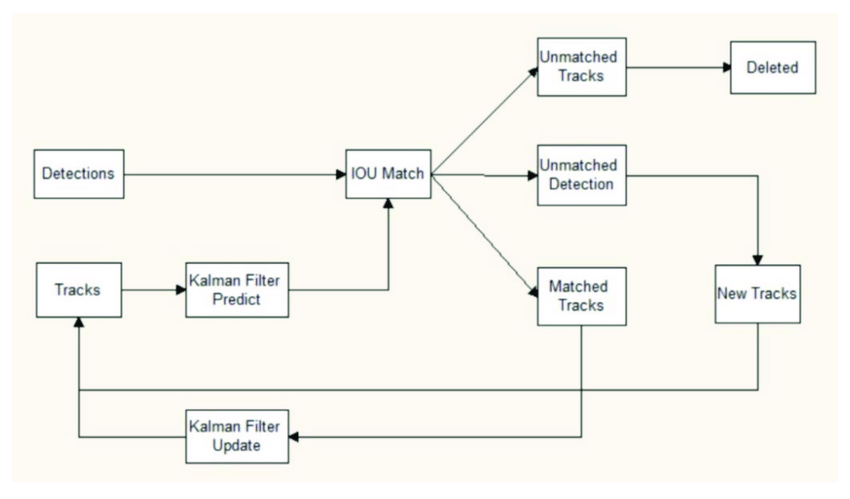

In [ ]:
#!git clone --recurse-submodules https://github.com/mikel-brostrom/Yolov5_StrongSORT_OSNet.git

Cloning into 'Yolov5_DeepSort_Pytorch'...
remote: Enumerating objects: 1467, done.
remote: Counting objects: 100% (95/95), done.
remote: Compressing objects: 100% (52/52), done.
remote: Total 1467 (delta 49), reused 83 (delta 40), pack-reused 1372
Receiving objects: 100% (1467/1467), 36.00 MiB | 13.95 MiB/s, done.
Resolving deltas: 100% (727/727), done.
Submodule 'strong_sort/deep/reid' (https://github.com/KaiyangZhou/deep-person-reid) registered for path 'strong_sort/deep/reid'
Submodule 'yolov5' (https://github.com/ultralytics/yolov5.git) registered for path 'yolov5'
Cloning into '/content/drive/MyDrive/Colab_Notebooks/MSc_Project/Project_V4/Yolov5_DeepSort_Pytorch/strong_sort/deep/reid'...
remote: Enumerating objects: 9833, done.        
remote: Counting objects: 100% (10/10), done.        
remote: Compressing objects: 100% (9/9), done.        
remote: Total 9833 (delta 1), reused 8 (delta 1), pack-reused 9823        
Receiving objects: 100% (9833/9833), 9.57 MiB | 9.24 MiB/s, done.

In [ ]:
# Changing directory before installing all necessary requirements
%cd 'Yolov5_StrongSORT_OSNet'

/content/drive/MyDrive/Colab_Notebooks/MSc_Project/Project_V5/Yolov5_StrongSORT_OSNet


In [ ]:
!pip install -r requirements.txt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 5.9 MB 5.2 MB/s 
     |████████████████████████████████| 61 kB 503 kB/s 
     |████████████████████████████████| 190 kB 56.5 MB/s 
     |████████████████████████████████| 42 kB 1.1 MB/s 
     |████████████████████████████████| 66 kB 2.9 MB/s 
     |████████████████████████████████| 41 kB 402 kB/s 
     |████████████████████████████████| 61 kB 514 kB/s 
     |████████████████████████████████| 61 kB 506 kB/s 
     |████████████████████████████████| 61 kB 349 kB/s 
     |████████████████████████████████| 61 kB 290 kB/s 
     |████████████████████████████████| 64 kB 2.6 MB/s 
     |████████████████████████████████| 64 kB 2.7 MB/s 
     |████████████████████████████████| 73 kB 1.9 MB/s 
     |████████████████████████████████| 41 kB 576 kB/s 
     |████████████████████████████████| 68 kB 6.5 MB/s 


In [ ]:
import time
start_time = time.time()

file_path =  '/content/test_video.mp4'
#file_path =  '/content/test_short_1.mp4'
#model_path = '/content/drive/MyDrive/Colab_Notebooks/MSc_Project/Project_V5/yolov5/runs/train/Largest_model_SGD_img_1280/weights/best.pt'
model_path = '/content/drive/MyDrive/Colab_Notebooks/MSc_Project/Project_V5/yolov5/runs/train/exp4/weights/best.pt' #

'''
Saved output format frame,id,x1,y1,x2,y2,1,-1,-1,-1 where,
frame: frame number
id: id of the tracked object
x1, y1: left top coordinates
x2, y2: right bottom coordinates'''
#!python3 track.py --source {file_path} --save-vid --yolo-weights {model_path} --img 640 --save-txt
#!python3 track.py --source {file_path} --save-vid --strong-sort-weights osnet_x0_25_msmt17.pt #Model trained on COCO dataset
# --classes
!python3 track.py --source {file_path} --save-vid --yolo-weights {model_path} --img 800 --save-txt --conf-thres 0.2 #--classes 0

print("The code was executed in %s seconds " % (time.time() - start_time))

strong_sort/deep/reid/torchreid/metrics/rank.py:12: UserWarning: Cython evaluation (very fast so highly recommended) is unavailable, now use python evaluation.
  'Cython evaluation (very fast so highly recommended) is '
track: yolo_weights=['/content/drive/MyDrive/Colab_Notebooks/MSc_Project/Project_V5/yolov5/runs/train/exp4/weights/best.pt'], strong_sort_weights=/content/drive/MyDrive/Colab_Notebooks/MSc_Project/Project_V5/Yolov5_StrongSORT_OSNet/weights/osnet_x0_25_msmt17.pt, config_strongsort=strong_sort/configs/strong_sort.yaml, source=/content/test_video.mp4, imgsz=[800, 800], conf_thres=0.2, iou_thres=0.5, max_det=1000, device=, show_vid=False, save_txt=True, save_conf=False, save_crop=False, save_vid=True, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/track, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, hide_class=False, half=False, dnn=False
YOLOv5 🚀 2022-7-12 Python-3.7.13 torch-1.12

In [ ]:
import cv2
# Want to get info about input video to display it to the user, as well as further extraction for time occurance of tracked objects (Need exact frame etc.)
file_path =  '/content/test_video.mp4'
video_file = cv2.VideoCapture(file_path)

video_fps = video_file.get(cv2.CAP_PROP_FPS)
total_frames = video_file.get(cv2.CAP_PROP_FRAME_COUNT)
height = video_file.get(cv2.CAP_PROP_FRAME_HEIGHT)
width = video_file.get(cv2.CAP_PROP_FRAME_WIDTH)
video_time = total_frames/video_fps
print(f" \n The input video info: \n Frames per second: {video_fps } \n Total Frames: {total_frames} \n Height: {height} \n Width: {width} \n Video length: {video_time}")

 
 The input video info: 
 Frames per second: 25.0 
 Total Frames: 346.0 
 Height: 720.0 
 Width: 1280.0 
 Video length: 13.84


# Further Processing - Extracting Data
**Importing objects data extracted from tracking function and flipping Y coordinates (explained below)**

In [ ]:
import pandas as pd
#Bottom player
Bottom_player_X =  '/content/drive/MyDrive/Colab_Notebooks/MSc_Project/Project_V5/Yolov5_StrongSORT_OSNet/Objects_coordinates/Bottom_player_X.csv'
Bottom_player_X = pd.read_csv(Bottom_player_X)
Bottom_player_X = Bottom_player_X['X']

Bottom_player_Y =  '/content/drive/MyDrive/Colab_Notebooks/MSc_Project/Project_V5/Yolov5_StrongSORT_OSNet/Objects_coordinates/Bottom_player_Y.csv'
Bottom_player_Y = pd.read_csv(Bottom_player_Y)
Bottom_player_Y = Bottom_player_Y['Y']

Total_dist_bottom_player =  '/content/drive/MyDrive/Colab_Notebooks/MSc_Project/Project_V5/Yolov5_StrongSORT_OSNet/Objects_coordinates/Total_dist_bottom_player.csv'
Total_dist_bottom_player = pd.read_csv(Total_dist_bottom_player)
Total_dist_bottom_player = Total_dist_bottom_player['distance']

Speed_bottom_player =  '/content/drive/MyDrive/Colab_Notebooks/MSc_Project/Project_V5/Yolov5_StrongSORT_OSNet/Objects_coordinates/Speed_bottom_player.csv'
Speed_bottom_player = pd.read_csv(Speed_bottom_player)
Speed_bottom_player = Speed_bottom_player['speed']

#Top player
Top_player_X =  '/content/drive/MyDrive/Colab_Notebooks/MSc_Project/Project_V5/Yolov5_StrongSORT_OSNet/Objects_coordinates/Top_player_X.csv'
Top_player_X = pd.read_csv(Top_player_X)
Top_player_X = Top_player_X['X']

Top_player_Y =  '/content/drive/MyDrive/Colab_Notebooks/MSc_Project/Project_V5/Yolov5_StrongSORT_OSNet/Objects_coordinates/Top_player_Y.csv'
Top_player_Y = pd.read_csv(Top_player_Y)
Top_player_Y = Top_player_Y['Y']

Total_dist_top_player =  '/content/drive/MyDrive/Colab_Notebooks/MSc_Project/Project_V5/Yolov5_StrongSORT_OSNet/Objects_coordinates/Total_dist_top_player.csv'
Total_dist_top_player = pd.read_csv(Total_dist_top_player)
Total_dist_top_player = Total_dist_top_player['distance']

Speed_top_player =  '/content/drive/MyDrive/Colab_Notebooks/MSc_Project/Project_V5/Yolov5_StrongSORT_OSNet/Objects_coordinates/Speed_top_player.csv'
Speed_top_player = pd.read_csv(Speed_top_player)
Speed_top_player = Speed_top_player['speed']

#Ball
Ball_coord_X =  '/content/drive/MyDrive/Colab_Notebooks/MSc_Project/Project_V5/Yolov5_StrongSORT_OSNet/Objects_coordinates/Ball_coord_X.csv'
Ball_coord_X = pd.read_csv(Ball_coord_X)
Ball_coord_X = Ball_coord_X['X']

Ball_coord_Y =  '/content/drive/MyDrive/Colab_Notebooks/MSc_Project/Project_V5/Yolov5_StrongSORT_OSNet/Objects_coordinates/Ball_coord_Y.csv'
Ball_coord_Y = pd.read_csv(Ball_coord_Y)
Ball_coord_Y = Ball_coord_Y['Y']

#For time
Total_top_play_det_time =  '/content/drive/MyDrive/Colab_Notebooks/MSc_Project/Project_V5/Yolov5_StrongSORT_OSNet/Objects_coordinates/Total_top_play_det_time.csv'
Total_top_play_det_time = pd.read_csv(Total_top_play_det_time)
Total_top_play_det_time = Total_top_play_det_time['time']


#Since Y coordinate is invert/flipped and its '0 value' starts in top of the screen/frame, need to change it to could correctly display the data plot. Otherwise need to use plt.gca().invert_yaxis() that not always works
Bottom_player_Y_fixed = []
Top_player_Y_fixed = []
Ball_coord_Y_fixed = []

for i in Bottom_player_Y:
  fixed_Y = int(height - i)
  Bottom_player_Y_fixed.append(fixed_Y)

for i in Top_player_Y:
  fixed_Y = int(height - i)
  Top_player_Y_fixed.append(fixed_Y)

for i in Ball_coord_Y:
  fixed_Y = int(height - i)
  Ball_coord_Y_fixed.append(fixed_Y)

In [ ]:
# Creating two dataframes from extracted data: one for players, second for a tennis ball object
# Dataframe for ball object
player_df = pd.DataFrame(Top_player_X,
                  columns=['X'])
player_df.rename(columns = {'X':'X_top'}, inplace = True) # For some reason gettint NaN while giving this column name at first. This fix the problem, so need to rename

player_df['Y_top'] = Top_player_Y_fixed
player_df['speed_top'] = Speed_top_player
player_df['distance_top'] = Total_dist_top_player
# Adding bottom side player here:
player_df['X_bottom'] = Bottom_player_X
player_df['Y_bottom'] = Bottom_player_Y_fixed
player_df['speed_bottom'] = Speed_bottom_player
player_df['distance_bottom'] = Total_dist_bottom_player

player_df['det_time'] = Total_top_play_det_time

# Dataframe for ball object
ball_df = pd.DataFrame(Ball_coord_X,
                  columns=['X'])
ball_df['Y'] = Ball_coord_Y_fixed

In [ ]:
det_perf_player = round(len(Top_player_X)/ total_frames,3)
det_perf_ball = round(len(Ball_coord_X)/ total_frames,3)
print(f" A player object was detected in {len(Top_player_X)} frames, and tennis ball in {len(Ball_coord_X)} frames, out of total {int(total_frames)} frames in the video")
print(f" Tracking accuracy for player object is: \n {det_perf_player*100} % \n and for tennis ball: \n {det_perf_ball*100} % ")

 A player object was detected in 344 frames, and tennis ball in 254 frames, out of total 346 frames in the video
 Tracking accuracy for player object is: 
 99.4 % 
 and for tennis ball: 
 73.4 % 


In [ ]:
# Additional dataframes for comparison

player_speed_df = pd.DataFrame(Speed_top_player,
                  columns=['speed'])
player_speed_df.rename(columns = {'speed':'speed_top'}, inplace = True) # For some reason gettint NaN while giving this column name at first. This fix the problem, so need to rename
player_speed_df['speed_bottom'] = Speed_bottom_player

player_dist_df = pd.DataFrame(Total_dist_top_player,
                  columns=['distance'])
player_dist_df.rename(columns = {'distance':'distance_top'}, inplace = True) # For some reason gettint NaN while giving this column name at first. This fix the problem, so need to rename
player_dist_df['distance_bottom'] = Total_dist_bottom_player

In [ ]:
player_df.describe()

,X_top,Y_top,speed_top,distance_top,X_bottom,Y_bottom,speed_bottom,distance_bottom,det_time
count,344.000000,344.000000,344.000000,344.000000,344.000000,344.00000,344.000000,344.000000,344.000000
mean,696.186047,536.494186,4.508721,24.191686,622.645349,134.02907,5.526163,38.286977,6.980000
std,120.629569,20.879216,4.455145,18.265391,129.918440,113.48993,4.369842,25.627651,3.977939
min,501.000000,501.000000,0.000000,0.000000,408.000000,1.00000,0.000000,0.000000,0.120000
25%,596.750000,517.000000,1.000000,7.177500,526.000000,26.75000,2.000000,14.180000,3.550000
50%,691.000000,539.500000,4.000000,21.978000,595.500000,132.00000,5.000000,35.860000,6.980000
75%,805.000000,558.000000,8.000000,36.943500,731.500000,212.75000,8.000000,62.480000,10.410000
max,901.000000,572.000000,28.000000,59.730000,884.000000,342.00000,33.000000,85.520000,13.840000


In [ ]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

from matplotlib.ticker import NullFormatter, MaxNLocator
from numpy import linspace
from pandas.plotting import bootstrap_plot

no_of_sec = round(video_time) # Want to plot approximately one point per second of the video

**Kdplot**


Kernel Distribution Estimation Plot (Kdplot) or kernel density estimate, allows to present data in density function. The seaborn.kdeplot() function shows the probability distribution of data presented as the area under the curve.

[Text(0, 0.5, 'Y coordinates')]

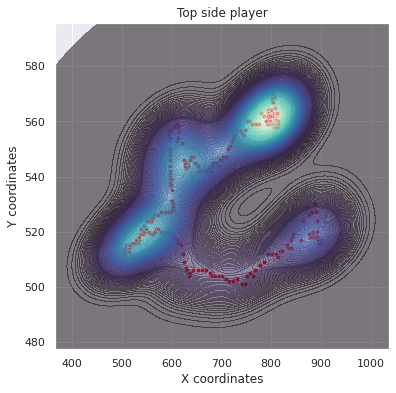

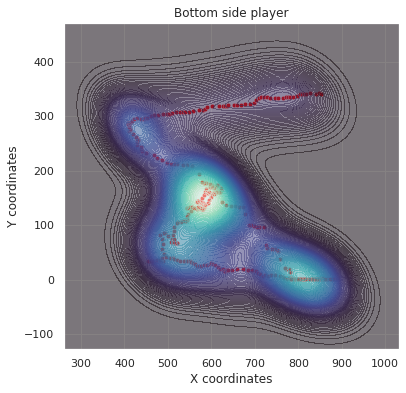

In [ ]:
# Drawing a combined scatterplot with density contours
X = player_df['X_top']
Y = player_df['Y_top']

f, ax = plt.subplots(figsize=(6, 6))

kde = sns.scatterplot(x=X, y=Y, s=19, color="red").set(title='Top side player')
kde = sns.kdeplot(x=X, y=Y, levels=120,
   alpha=.5,shade=True, cmap="mako",fill=True, thresh=0)
kde.set(xlabel="X coordinates")
kde.set(ylabel="Y coordinates")
#For bottom player
X = player_df['X_bottom']
Y = player_df['Y_bottom']

f, ax = plt.subplots(figsize=(6, 6))

kde = sns.scatterplot(x=X, y=Y, s=19, color="red").set(title='Bottom side player')
kde = sns.kdeplot(x=X, y=Y, levels=120,
   alpha=.5, cmap="mako",fill=True, thresh=0)
kde.set(xlabel="X coordinates")
kde.set(ylabel="Y coordinates")

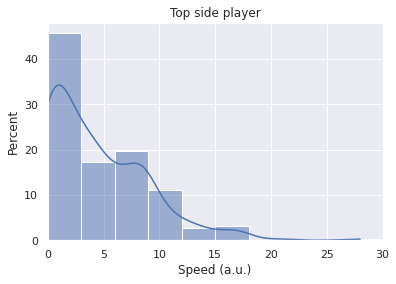

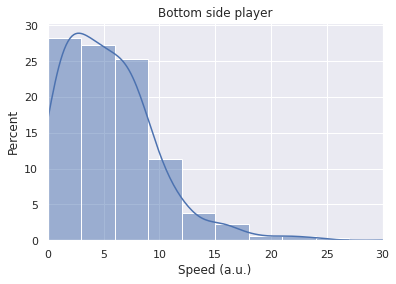

In [ ]:
sns.set(style="darkgrid")
hist = sns.histplot(player_df, x="speed_top", kde=True, binwidth=3, stat="percent") #bins=15
hist.set(xlim=(0, 30))
hist.set(xlabel="Speed (a.u.)")
hist.set(title='Top side player')
plt.show()

sns.set(style="darkgrid")
hist = sns.histplot(player_df, x="speed_bottom", kde=True, binwidth=3,bins=15, stat="percent") #bins=15
hist.set(xlim=(0, 30))
hist.set(xlabel="Speed (a.u.)")
hist.set(title='Bottom side player')
plt.show()

[Text(0.5, 1.0, 'Normalized probability density distribution')]

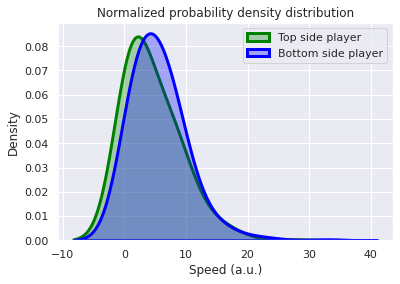

In [ ]:
kde = sns.kdeplot(
   player_df['speed_top'] ,
   fill=True, common_norm=False, palette="crest",
   alpha=.3, linewidth=3,color='green',shade=True,bw_adjust=2
) # apply bw_adjust to normalize the curve

kde = sns.kdeplot(
   player_df['speed_bottom'] ,
   fill=True, common_norm=False, palette="crest",
   alpha=.3, linewidth=3,color='blue',shade=True,bw_adjust=2
)
kde.legend(labels=['Top side player', 'Bottom side player'], loc='upper right'); # ncol=2
kde.set(xlabel="Speed (a.u.)")
kde.set(title='Normalized probability density distribution')

[Text(0.5, 1.0, 'Probability density distribution')]

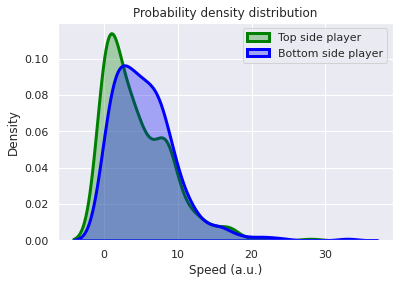

In [ ]:
kde = sns.kdeplot(
   player_df['speed_top'] ,
   fill=True, common_norm=False, palette="crest",
   alpha=.3, linewidth=3,color='green',shade=True
) # apply bw_adjust to normalize the curve

kde = sns.kdeplot(
   player_df['speed_bottom'] ,
   fill=True, common_norm=False, palette="crest",
   alpha=.3, linewidth=3,color='blue',shade=True
)
kde.legend(labels=['Top side player', 'Bottom side player'], loc='upper right'); # ncol=2
kde.set(xlabel="Speed (a.u.)")
kde.set(title='Probability density distribution')

[Text(0.5, 1.0, 'Normalized probability density distribution')]

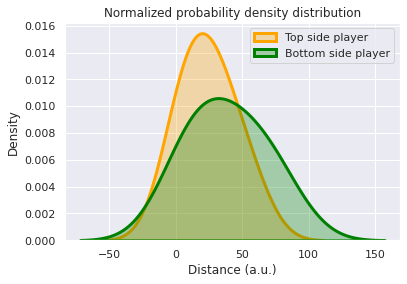

In [ ]:
kde = sns.kdeplot(
   x=player_df['distance_top'] ,
   fill=True, common_norm=False, palette="crest",
   alpha=.3, linewidth=3, color='orange', shade=True, bw_adjust=3
) # apply bw_adjust to normalize the curve

kde = sns.kdeplot(
   x=player_df['distance_bottom'] ,
   fill=True, common_norm=False, palette="crest",
   alpha=.3, linewidth=3, color='green', shade=True, bw_adjust=3
)
kde.legend(labels=['Top side player', 'Bottom side player'], loc='upper right'); # ncol=2
kde.set(xlabel="Distance (a.u.)")
kde.set(title='Normalized probability density distribution')

[Text(0.5, 1.0, 'Probability density distribution')]

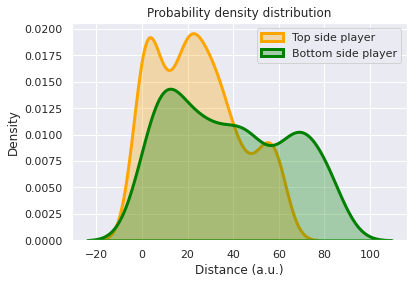

In [ ]:
kde = sns.kdeplot(
   x=player_df['distance_top'] ,
   fill=True, common_norm=False, palette="crest",
   alpha=.3, linewidth=3,color='orange',shade=True
) # apply bw_adjust to normalize the curve

kde = sns.kdeplot(
   x=player_df['distance_bottom'] ,
   fill=True, common_norm=False, palette="crest",
   alpha=.3, linewidth=3,color='green',shade=True
)
kde.legend(labels=['Top side player', 'Bottom side player'], loc='upper right'); # ncol=2
kde.set(xlabel="Distance (a.u.)")
kde.set(title='Probability density distribution')

[Text(0.5, 1.0, 'Speed comparison; top side player: green, bottom: red')]

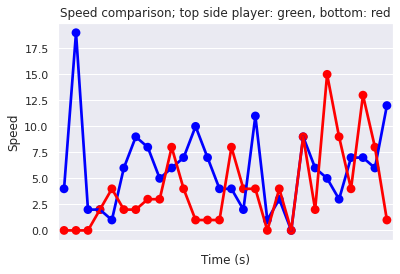

In [ ]:
plot=sns.pointplot(data=player_df.sample(no_of_sec*2), x= 'det_time', y='speed_bottom', color='blue', linestyles= '-', ci='sd')
plot=sns.pointplot(data=player_df.sample(no_of_sec*2), x= 'det_time', y='speed_top', color='red', linestyles= '-', ci='sd')
plot.set(xticklabels=[]) # removing labels on x axis
plot.set(xlabel="Time (s)")
plot.set(ylabel="Speed")

plot.set(title='Speed comparison; top side player: green, bottom: red')
#plt.legend(labels=['Top side player','Bottom side player'], loc='upper left') # ncol=2

In [ ]:
player_df[["distance_top", "distance_bottom"]].median()

distance_top       21.978
distance_bottom    35.860
dtype: float64

[Text(0.5, 1.0, 'Speed distribution (with mean) during tennis play sample')]

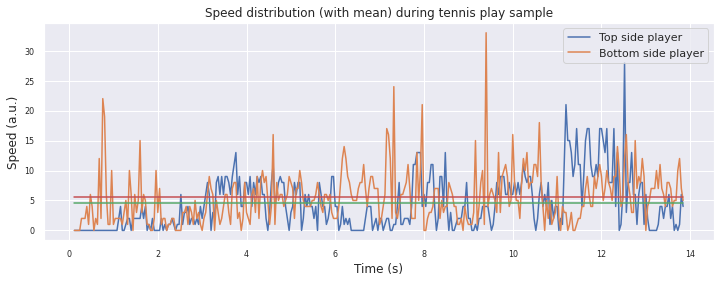

In [ ]:
#CAN ALSO DO WITH MAX VALUES
fig, axs = plt.subplots(figsize=(12, 4))

med_top = player_df['speed_top'].mean()
med_bottom = player_df['speed_bottom'].mean()


player_copy = player_df.copy()
player_copy['mean_speed_top'] = med_top
player_copy['mean_speed_bottom'] = med_bottom
p = player_copy.plot(x="det_time", y=['speed_top', 'speed_bottom',  'mean_speed_top', 'mean_speed_bottom'], fontsize=8,ax=axs)

p.legend(labels=['Top side player', 'Bottom side player'], loc='upper right'); # ncol=2
p.set(xlabel="Time (s)")
p.set(ylabel="Speed (a.u.)")
p.set(title='Speed distribution (with mean) during tennis play sample')

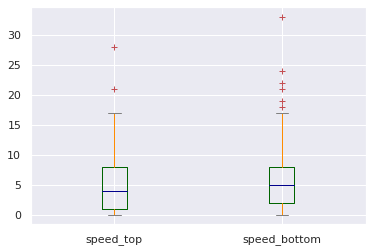

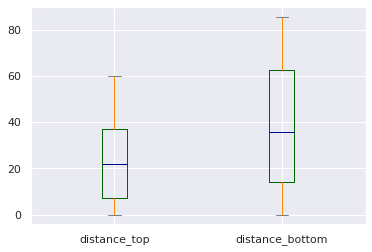

In [ ]:
color = {
    "boxes": "DarkGreen",
    "whiskers": "DarkOrange",
    "medians": "DarkBlue",
    "caps": "Gray",
}

player_speed_df.plot.box(color=color, sym="r+");
player_dist_df.plot.box(color=color, sym="r+");

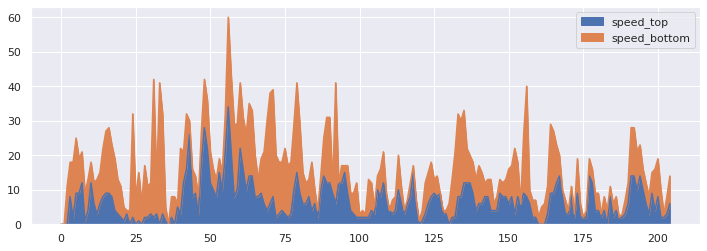

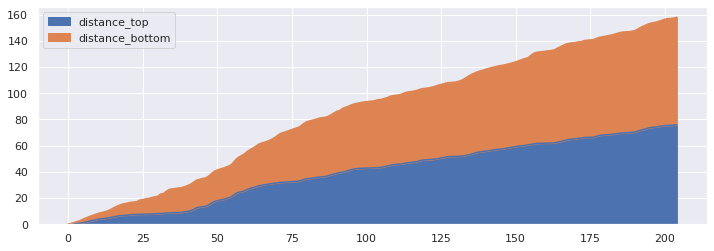

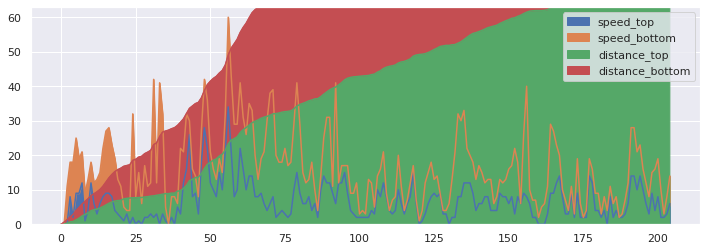

In [ ]:
# kind: box, kde, density, area, scatter, hexbin
fig, axs = plt.subplots(figsize=(12, 4))
player_speed_df.plot.area(ax=axs)
fig, axs = plt.subplots(figsize=(12, 4))
player_dist_df.plot.area(ax=axs)

fig, axs = plt.subplots(figsize=(12, 4))
player_speed_df.plot.area(ax=axs)
player_dist_df.plot.area(ax=axs)

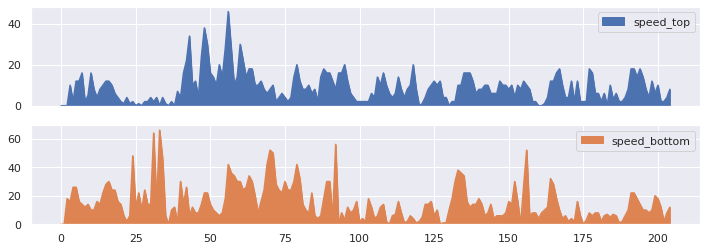

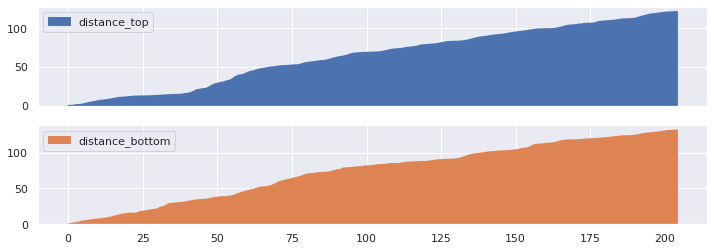

In [ ]:
axs = player_speed_df.plot.area(figsize=(12, 4), subplots=True)
axs = player_dist_df.plot.area(figsize=(12, 4), subplots=True)

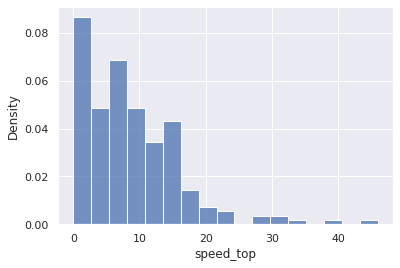

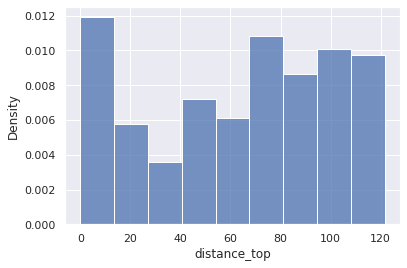

In [ ]:
sns.histplot(data = player_df, x = 'speed_top', common_norm = False, stat = 'density')
plt.show()
sns.histplot(data = player_df, x = 'distance_top', common_norm = False, stat = 'density')

<Figure size 432x288 with 0 Axes>

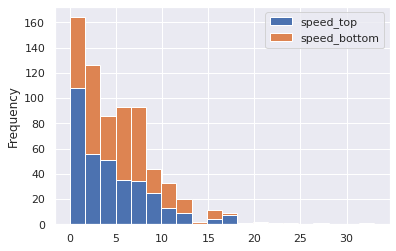

In [ ]:
plt.figure();
player_speed_df.plot.hist(stacked=True, bins=20);

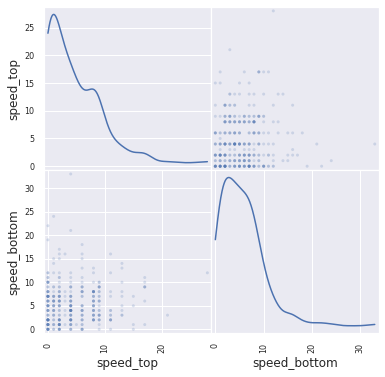

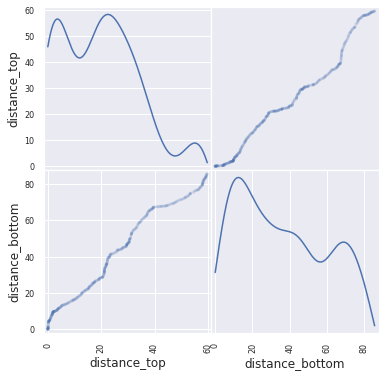

In [ ]:
from pandas.plotting import scatter_matrix

scatter_matrix(player_speed_df, alpha=0.2, figsize=(6, 6), diagonal="kde");
scatter_matrix(player_dist_df, alpha=0.2, figsize=(6, 6), diagonal="kde");

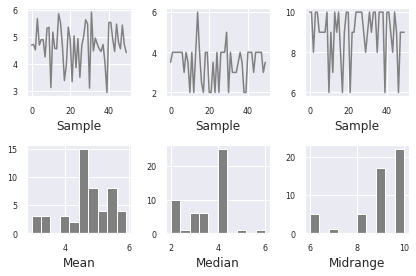

In [ ]:
bootstrap_plot(player_df['speed_top'], size=50, samples=50, color="grey");

In [ ]:
https://seaborn.pydata.org/generated/seaborn.kdeplot.html

In [ ]:
player_df.head()

,X_top,Y_top,speed_top,distance_top,X_bottom,Y_bottom,speed_bottom,distance_bottom,det_time
0,806,558,0,0.0,544,131,0,0.00,0.12
1,806,558,0,0.0,544,132,0,0.04,0.16
2,806,558,0,0.0,544,132,0,0.04,0.20
3,806,558,0,0.0,545,132,0,0.08,0.24
4,806,558,0,0.0,547,132,2,0.16,0.28


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


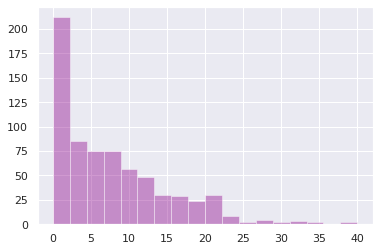

In [ ]:
sns.distplot(player_speed_df, color="darkmagenta", kde=False, rug=False)

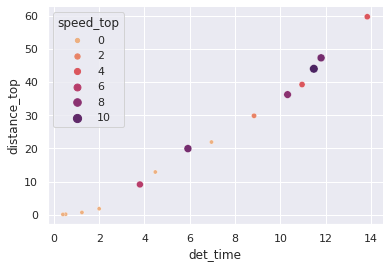

In [ ]:
sns.set_style("darkgrid")
sns.scatterplot(data=player_df.sample(no_of_sec), x="det_time", y='distance_top', hue='speed_top', palette="flare", size="speed_top") #Try sizes=(20, 250)  marker="+" data=player_df.sample(10)  , bins=40 , samples=50

# This will remove the top and right sides of the frame.
sns.despine()

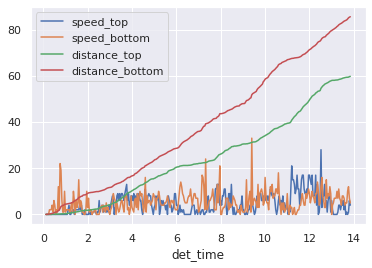

In [ ]:
player_df.plot(x="det_time", y=['speed_top', 'speed_bottom','distance_top','distance_bottom'])
plt.show()